In [ ]:
# Import all required modules

import IPython.display as ipd
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from sklearn.utils import class_weight
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
import os

IM_SIZE = (224, 224, 3)
DATA_PATH = '/content/drive/MyDrive/10SecSplitMajor'
BIRDS = os.listdir(DATA_PATH)
BATCH_SIZE = 16

# Audio Analysis


In [ ]:
!pip install pydub
from pydub import AudioSegment
import os

os.chdir('/content')
DATA_PATH = '/content/drive/MyDrive/MajorProject/DatasetRaw'
BIRDS = os.listdir(DATA_PATH)

# Find maximum amplitude for each birds
amp_max = {}
for bird in BIRDS:
    amp_max[bird] = []
    for audio_file in os.listdir(os.path.join(DATA_PATH, bird)):
        os.chdir(os.path.join(DATA_PATH, bird))
        try:
            audio = AudioSegment.from_mp3(audio_file)
        except:
            print("File handled: ", audio_file)
            audio = AudioSegment.from_wav(audio_file)
        amp_max[bird].append(audio.max)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
File handled:  XC653450 - Grey-sided Thrush - Turdus feae.mp3


In [ ]:
import pandas as pd
import numpy as np

# Find average of the amplitude for each bird category
avg_max_amp = {}
for k in amp_max.keys():
    avg_max_amp[k] = round(np.array(amp_max[k]).mean(), 2)
amp_df = pd.DataFrame(data= {'Birds': avg_max_amp.keys(), 'Avg. Max. Amplitude': avg_max_amp.values()})
# amp_df
amp_df.sort_values('Avg. Max. Amplitude', ascending=False, inplace=True)

In [ ]:
amp_df.reset_index(inplace=True)

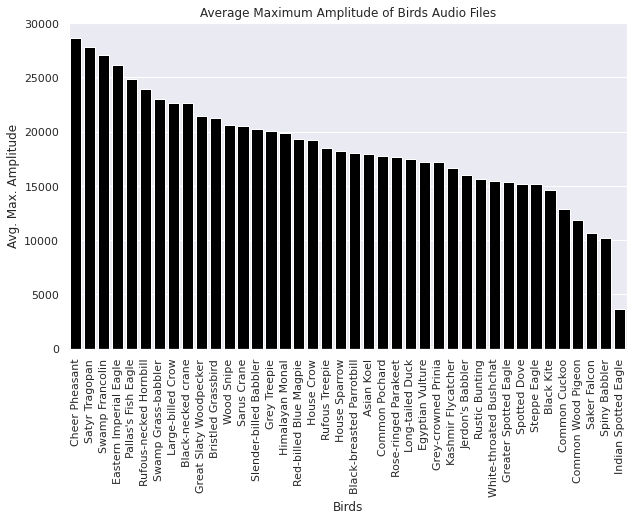

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set()

plt.figure(figsize=(10, 6))
plt.title("Average Maximum Amplitude of Birds Audio Files")
plt.xlabel("Birds")
plt.ylabel("Average Maximum Amplitude (in Hz)")
plt.xticks(rotation=90)
sns.barplot(y= "Avg. Max. Amplitude", x = "Birds", data = amp_df.iloc[1:, 1:], color='black')

In [ ]:
import numpy as np
np.array(amp_max['Great Slaty Woodpecker']).mean()

21882.58695652174

In [ ]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams.update({'font.size': 22})
sns.set()

bird_count = {}
DATA_PATH = '/content/drive/MyDrive/10SecSplitMajor'
BIRDS = os.listdir(DATA_PATH)

for bird in BIRDS:
    bird_count[bird] = len(os.listdir(os.path.join(DATA_PATH, bird)))

In [ ]:
birds_to_augment = [k for k, v in bird_count.items() if v<30]
birds_to_augment


['Saker Falcon',
 'Swamp Francolin',
 'Eastern Imperial Eagle',
 'Kashmir Flycatcher',
 'White-throated Bushchat',
 'Black-breasted Parrotbill',
 'Indian Spotted Eagle',
 'Steppe Eagle',
 'Egyptian Vulture',
 "Pallas's Fish Eagle",
 'Cheer Pheasant',
 'Grey-crowned Prinia',
 'Swamp Grass-babbler']

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40]),
 <a list of 41 Text major ticklabel objects>)

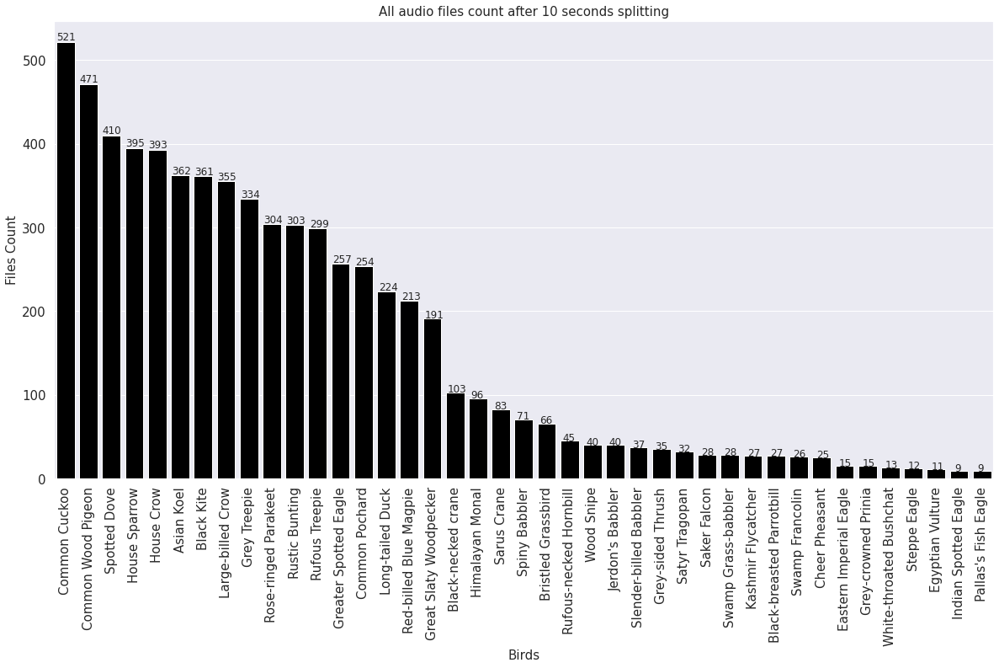

In [ ]:
# Bird files count plot

k = sorted(bird_count.items(), key=lambda x:x[1], reverse=True)
x = [i[0] for i in k]
y = [i[1] for i in k]

plt.figure(figsize=(20, 10))
ax = sns.barplot(x, y, color='black')
for p in ax.patches:
    ax.annotate(str(int(p.get_height())), (p.get_x() * 1.005, p.get_height() * 1.005))
plt.title('All audio files count after 10 seconds splitting', fontsize=15)
plt.xlabel('Birds', fontsize=15)
plt.ylabel('Files Count', fontsize=15)
ax.tick_params(axis='both', which='major', labelsize=15)
plt.xticks(rotation=90)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40]),
 <a list of 41 Text major ticklabel objects>)

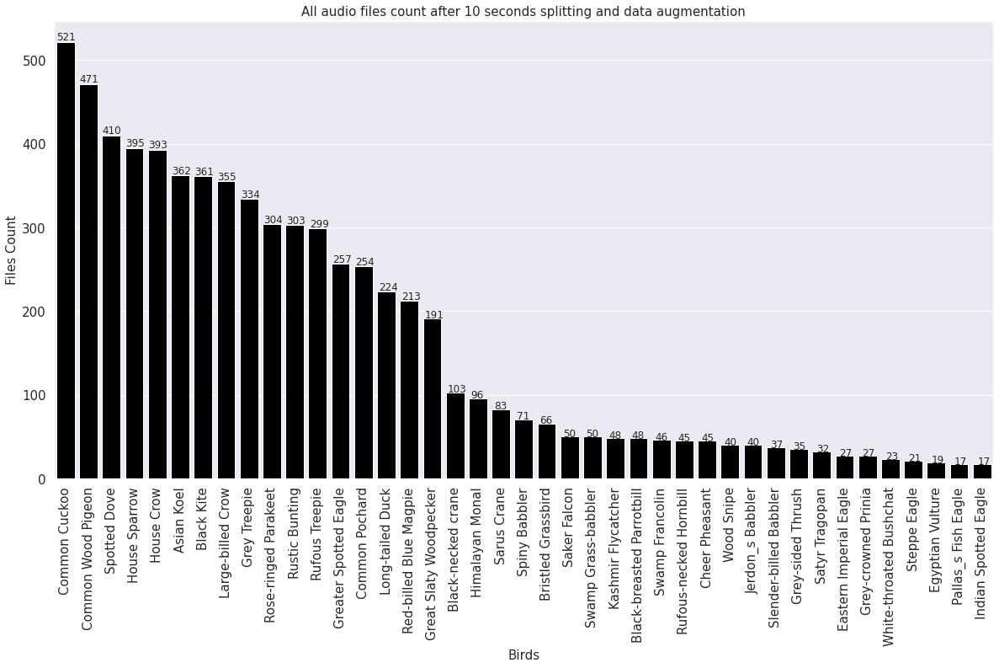

In [ ]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams.update({'font.size': 22})
sns.set()

bird_count_train = {}
bird_count_val = {}
bird_count_test = {}

def bird_counter(tvt):
    bird_count_dict = {}
    DATA_PATH = f'/content/drive/MyDrive/ScalogramMidFinal/{tvt}'
    BIRDS = os.listdir(DATA_PATH)

    for bird in BIRDS:
        bird_count_dict[bird] = len(os.listdir(os.path.join(DATA_PATH, bird)))

    return bird_count_dict

bird_count_train = bird_counter('train')
bird_count_val = bird_counter('val')
bird_count_test = bird_counter('test')
bird_count = {}
for keys, values in bird_count_train.items():
    bird_count[keys] = bird_count_train[keys] + bird_count_val[keys] + bird_count_test[keys]

k = sorted(bird_count.items(), key=lambda x:x[1], reverse=True)
x = [i[0] for i in k]
y = [i[1] for i in k]

plt.figure(figsize=(20, 10))
ax = sns.barplot(x, y, color='black')
for p in ax.patches:
    ax.annotate(str(int(p.get_height())), (p.get_x() * 1.005, p.get_height() * 1.005))
plt.title('All audio files count after 10 seconds splitting and data augmentation', fontsize=15)
plt.xlabel('Birds', fontsize=15)
plt.ylabel('Files Count', fontsize=15)
ax.tick_params(axis='both', which='major', labelsize=15)
plt.xticks(rotation=90)

# Train, Validation, Testing split

In [ ]:
!pip install split-folders
import splitfolders
splitfolders.ratio('/content/drive/MyDrive/10SecSplitMajor', output="/content/DataSplitted", seed=77, ratio=(.8, 0.1,0.1)) 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Copying files: 6540 files [11:41,  9.33 files/s]


# Data Augmentation for data less than 30

In [ ]:
# !pip install audiomentations

import librosa
import soundfile as sf
import numpy as np
import os
from audiomentations import Compose, AddGaussianNoise
from audiomentations import Compose, AddGaussianNoise

train_path = '/content/DataSplitted/train'

augment_raw_audio = Compose(
    [
        AddGaussianNoise(min_amplitude=0.01, max_amplitude=0.015, p=1)
    ]
)

for bird in birds_to_augment:
    os.chdir(os.path.join(train_path, bird))
    for filename in os.listdir(os.path.join(train_path, bird)):
        x, sr = librosa.load(filename)
        augmented_signal = augment_raw_audio(x, sr)
        sf.write(f'{filename}aug.wav', augmented_signal, sr, format='wav')
os.chdir('/content')

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/librosa/cor

In [ ]:
# Bird counts after augmentation

count = 0
for bird in os.listdir('/content/DataSplitted/train'):
    count = count + len(os.listdir(os.path.join('/content/DataSplitted/train', bird)))
count

5407

In [ ]:
count = 0
for bird in os.listdir('/content/DataSplitted/test'):
    count = count + len(os.listdir(os.path.join('/content/DataSplitted/test', bird)))
count

687

In [ ]:
count = 0
for bird in os.listdir('/content/DataSplitted/val'):
    count = count + len(os.listdir(os.path.join('/content/DataSplitted/val', bird)))
count

637

In [ ]:
# # import shutil

# # output_filename = 'DataAugmented'
# source = '/content/DataSplitted'
# # shutil.make_archive(output_filename, 'zip', source)

# destination = '/content/drive/MyDrive/MajorDataAugmented'
# shutil.copytree(source, destination)

'/content/drive/MyDrive/MajorDataAugmented'

# Audio splitting

In [ ]:
# Audio splitting to 10 seconds each
!pip install -q pydub

from pydub import AudioSegment
import math

validAudio = lambda audio, amp_threshold: True if audio.max > amp_threshold else False
def splitAudio(audio_file, export_category, sec_to_split=10):

    global temp_n
    temp_n = 0
    mili=1000
    export_folder = f'/content/splitted10Audio/{export_category}/'
    export_name = audio_file[:9]
    exportFormat = 'mp3'
    try:
        audio = AudioSegment.from_mp3(audio_file)
    except:
        print("File handled: ", audio_file)
        audio = AudioSegment.from_wav(audio_file)
    th = audio.max//2
 
    duration = math.floor(audio.duration_seconds)
    splits = np.arange(0, duration, sec_to_split)

    if duration > sec_to_split:
        rem = duration % sec_to_split
        n_splits = round(duration / sec_to_split)
        for n in range(n_splits-1): # Except last splitted file
            newAudio = audio[splits[n]*mili:splits[n+1]*mili]
            temp_n = n
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n}.{exportFormat}', format=exportFormat)
        
        # For the last splitted file
        if rem <= sec_to_split//2:
            n = temp_n
            # If remaining  audio is small enough, don't separate
            newAudio = audio[splits[n+1]*mili:duration*mili]
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n+1}.{exportFormat}', format=exportFormat)

        else:
            n = temp_n
            # If remaining audio is big enough, make it separate file
            newAudio = audio[splits[n+1]*mili:duration*mili]
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n+1}.{exportFormat}', format=exportFormat)

    else:
        if validAudio(audio, th):
            audio.export(f'{export_folder}/{export_name}original.{exportFormat}', format=exportFormat)

                        # extraAudio = audio[splits[n+2]*mili:duration]
            # if validAudio(extraAudio, th):
            #     extraAudio.export(f'{export_folder}/{export_name}Extra.{exportFormat}', format=exportFormat)

In [ ]:
import shutil
shutil.rmtree('/content/splitted10Audio')

In [ ]:
os.chdir('/content')
export_folder = '/content/splitted10Audio/'
os.mkdir(export_folder)

DATA_PATH = '/content/drive/MyDrive/MajorProjectDataset'
BIRDS = os.listdir(DATA_PATH)

for bird in BIRDS:
    os.mkdir(os.path.join(export_folder, bird))
    for audio_file in os.listdir(os.path.join(DATA_PATH, bird)):
        os.chdir(os.path.join(DATA_PATH, bird))
        splitAudio(audio_file, export_category=bird)

File handled:  XC653450 - Grey-sided Thrush - Turdus feae.mp3


In [ ]:
import shutil

os.chdir('/content')
output_filename= 'splitted'
dir_name = '/content/splitted10Audio'
shutil.make_archive(output_filename, 'zip', dir_name)
# shutil.copyfile(source, destination)

'/content/splitted.zip'

In [ ]:
src = '/content/splitted10Audio'
dest = '/content/drive/MyDrive/splitted_major100'
# shutil.copytree(src, dest)
source = '/content/splitted.zip'
destination = dest
shutil.copyfile(source, destination)

'/content/drive/MyDrive/splitted_major100'

In [ ]:
dir = '/content/splitted10Audio'
sum = 0
for bird in os.listdir(dir):
    sum += len(os.listdir(os.path.join(dir, bird)))
sum

6540

In [ ]:
from collections import OrderedDict
splitted_count = {}
for bird in os.listdir(export_folder):
    splitted_count[bird] = len(os.listdir(os.path.join(export_folder, bird)))
OrderedDict(sorted(splitted_count.items(), key = lambda x: x[1], reverse=True))


OrderedDict([('Common Cuckoo', 521),
             ('Common Wood Pigeon', 471),
             ('Spotted Dove', 410),
             ('House Sparrow', 395),
             ('House Crow', 393),
             ('Asian Koel', 362),
             ('Black Kite', 361),
             ('Large-billed Crow', 355),
             ('Grey Treepie', 334),
             ('Rose-ringed Parakeet', 304),
             ('Rustic Bunting', 303),
             ('Rufous Treepie', 299),
             ('Greater Spotted Eagle', 257),
             ('Common Pochard', 254),
             ('Long-tailed Duck', 224),
             ('Red-billed Blue Magpie', 213),
             ('Great Slaty Woodpecker', 191),
             ('Black-necked crane', 103),
             ('Himalayan Monal', 96),
             ('Sarus Crane', 83),
             ('Spiny Babbler', 71),
             ('Bristled Grassbird', 66),
             ('Rufous-necked Hornbill', 45),
             ("Jerdon's Babbler", 40),
             ('Wood Snipe', 40),
             ('Slender-bil

In [ ]:
from collections import OrderedDict
birds_count = {}
for bird in BIRDS:
    birds_count[bird] = len(os.listdir(os.path.join(DATA_PATH, bird)))
k = OrderedDict(sorted(birds_count.items(), key = lambda x: x[1], reverse=True))

filterBirds = []
for keys, values in k.items():
    if values>=20:
        filterBirds.append(keys)
filterBirds

['House Crow',
 'Asian Koel',
 'Common Cuckoo',
 'Black Kite',
 'Spotted Dove',
 'Common Wood Pigeon',
 'Rose-ringed Parakeet',
 'House Sparrow',
 'Large-billed Crow',
 'Rufous Treepie',
 'Grey Treepie',
 'Long-tailed Duck',
 'Common Pochard',
 'Rustic Bunting',
 'Red-billed Blue Magpie',
 'Great Slaty Woodpecker',
 'Greater Spotted Eagle',
 'Himalayan Monal',
 'Sarus Crane',
 'Black-necked crane',
 'Bristled Grassbird']

In [ ]:
# import shutil

# shutil.rmtree('/content/DataSpectrogram')

6540

# Mel Spectrogram Creation

In [ ]:
import os
import numpy as np
import shutil
import librosa
import librosa.display
import matplotlib.pyplot as plt
if 'DataMelVal' in os.listdir('/content'):
    shutil.rmtree('/content/DataMelVal')

In [ ]:
# exclude1 = os.listdir('/content/drive/MyDrive/ScalogramAug18/train')
# exclude2 = os.listdir('/content/drive/MyDrive/ScalogramAug18_2nd_lot/train')
# exclude = exclude1 + exclude2

# INCLUDE_BIRDS = [bird for bird in BIRDS if bird not in exclude]
# INCLUDE_BIRDS

test: Saker Falcon Started!!
test: Saker Falcon Done!!
test: Slender-billed Babbler Started!!
test: Slender-billed Babbler Done!!
test: Black-necked crane Started!!
test: Black-necked crane Done!!
test: Common Wood Pigeon Started!!
test: Common Wood Pigeon Done!!
test: House Sparrow Started!!
test: House Sparrow Done!!
test: Kashmir Flycatcher Started!!
test: Kashmir Flycatcher Done!!
test: Pallas_s Fish Eagle Started!!
test: Pallas_s Fish Eagle Done!!
test: Swamp Francolin Started!!
test: Swamp Francolin Done!!
test: Eastern Imperial Eagle Started!!
test: Eastern Imperial Eagle Done!!
test: Black-breasted Parrotbill Started!!
test: Black-breasted Parrotbill Done!!
test: Steppe Eagle Started!!
test: Steppe Eagle Done!!
test: House Crow Started!!
test: House Crow Done!!
test: Rustic Bunting Started!!
test: Rustic Bunting Done!!
test: Bristled Grassbird Started!!
test: Bristled Grassbird Done!!
test: White-throated Bushchat Started!!
test: White-throated Bushchat Done!!
test: Wood Snipe 

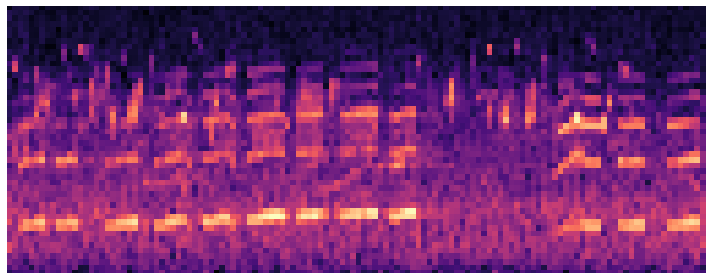

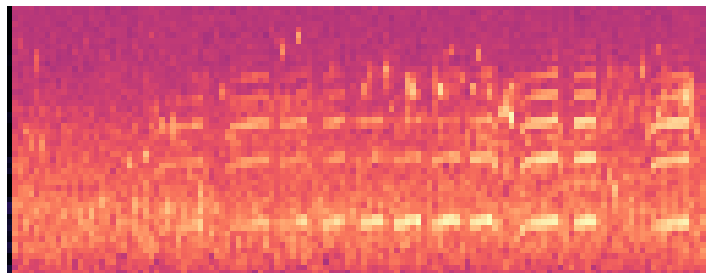

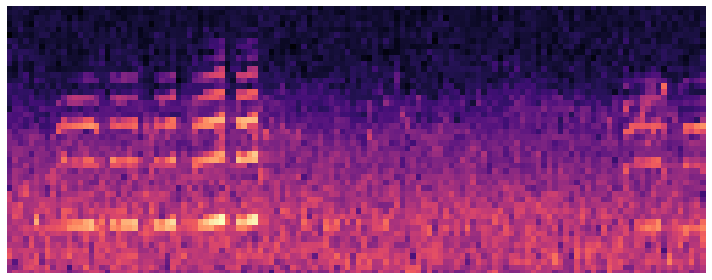

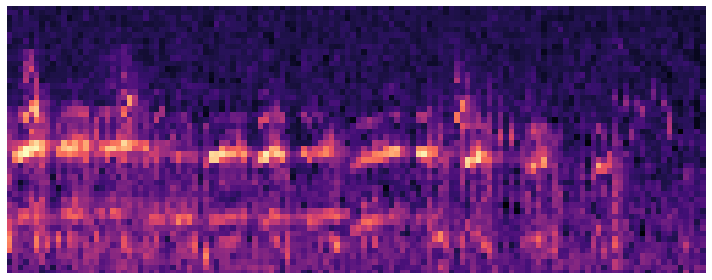

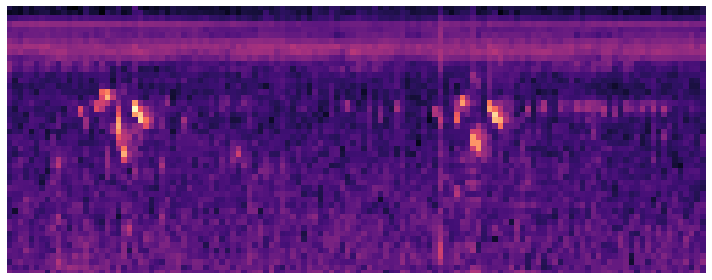

...

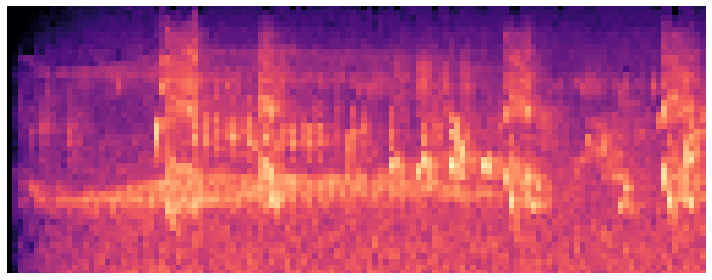

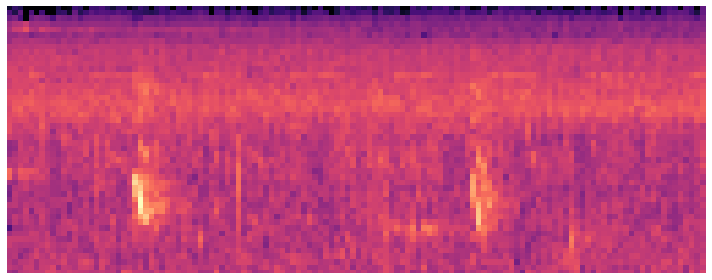

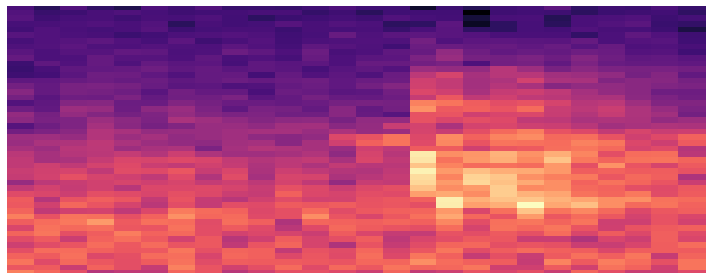

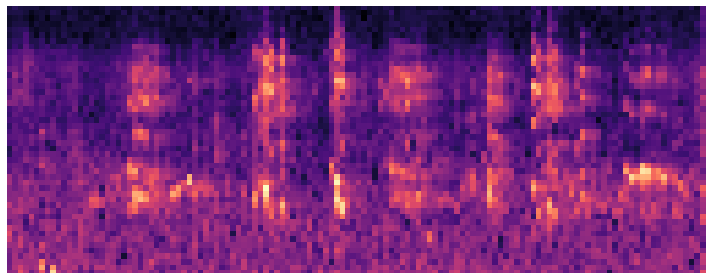

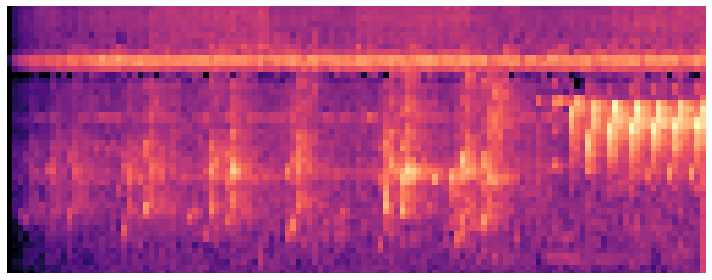

In [ ]:
import warnings
import os

warnings.filterwarnings("ignore")

PATH = '/content/drive/MyDrive/MajorProject/CharaNet'
SAVE_PATH = '/content/DataMelTest/'
BIRDS = os.listdir(PATH)

SAMPLE_RATE = 32000
SPEC_SHAPE = (48, 128) # height x width
SIGNAL_LENGTH = 10
N_FFT = 1024         
# HOP_SIZE = 1024   
HOP_SIZE =  int(SIGNAL_LENGTH * SAMPLE_RATE / (SPEC_SHAPE[1] - 1))    

# N_MELS = 128         
N_MELS = SPEC_SHAPE[0]   
WIN_SIZE = 1024      
WINDOW_TYPE = 'hann' 
FEATURE = 'mel'      
# FMIN = 1400 
FMIN = 500
FMAX = 12500

for train_val_test in ['train', 'val', 'test']:
# for train_val_test in ['test']:
    DATA_PATH = f'{PATH}/{train_val_test}'

    BIRDS = os.listdir(DATA_PATH)
    # BIRDS = INCLUDE_BIRDS
    os.chdir('/content')
    os.makedirs(f'DataMelTest/{train_val_test}')
    os.chdir(f'{SAVE_PATH}{train_val_test}')

    for bird in BIRDS:
        count = 0
        os.mkdir(bird)
        os.chdir(f'{SAVE_PATH}{train_val_test}/{bird}')

        # Load the mp3 file
        audio_files = os.listdir(os.path.join(DATA_PATH, bird))
        print(f"{train_val_test}: {bird} Started!!")
        for audio_data in audio_files:
            signal, sr = librosa.load(os.path.join(DATA_PATH, bird, audio_data), duration=10, sr=SAMPLE_RATE) # sr = sampling rate
            # Plot mel-spectrogram
        
            S = librosa.feature.melspectrogram(y=signal,
                                               sr=SAMPLE_RATE,
                                                n_fft=N_FFT,
                                                hop_length=HOP_SIZE, 
                                                n_mels=N_MELS, 
                                                fmin=FMIN, 
                                                fmax=FMAX) 

            plt.figure(figsize=(10, 4))
            mel_spec = librosa.power_to_db(S, ref=np.max) 
            librosa.display.specshow(mel_spec, fmin=FMIN,y_axis='linear')
            # plt.colorbar(format='%+2.0f dB')
            plt.axis(False)
            plt.tight_layout()
            # plt.show()
            count += 1
            plt.savefig(f'{bird}{count}.jpg')
        #     break
        # break
        print(f"{train_val_test}: {bird} Done!!")
        os.chdir(f'{SAVE_PATH}{train_val_test}')

In [ ]:
# import os
# import shutil
# shutil.rmtree('/content/DataMel/train/Himalayan Monal')

In [ ]:
import os
import shutil

os.chdir('/content')
# output_filename = 'MFCC'
SAVE_PATH = '/content/DataMelTest/'
source = SAVE_PATH
# shutil.make_archive(output_filename, 'zip', source)
destination = '/content/drive/MyDrive/MajorProject/DataMelCheck_Mangshir/test'
shutil.copytree(source, destination)

'/content/drive/MyDrive/MajorProject/DataMelCheck_Mangshir/test'

# Wavelet Transform Scalogram

In [ ]:
import os
import numpy as np
import shutil
if 'DataScalogram' in os.listdir('/content'):
    shutil.rmtree('/content/DataScalogram')

In [ ]:
# exclude1 = os.listdir('/content/drive/MyDrive/ScalogramAug18/train')
# exclude2 = os.listdir('/content/drive/MyDrive/ScalogramAug18_2nd_lot/train')
# exclude = exclude1 + exclude2

# INCLUDE_BIRDS = [bird for bird in BIRDS if bird not in exclude]
# INCLUDE_BIRDS

val: Spiny Babbler Started!!
val: Spiny Babbler Done!!
val: Red-billed Blue Magpie Started!!
val: Red-billed Blue Magpie Done!!
val: Long-tailed Duck Started!!
val: Long-tailed Duck Done!!
val: Asian Koel Started!!
val: Asian Koel Done!!
val: Great Slaty Woodpecker Started!!
val: Great Slaty Woodpecker Done!!


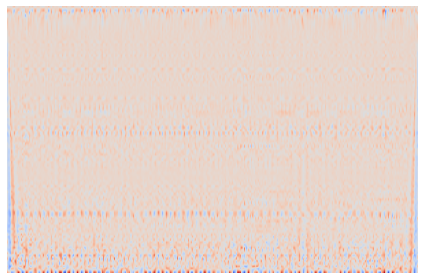

In [ ]:
import warnings
import librosa
import matplotlib.pyplot as plt
import pywt
import numpy as np
import cv2 as cvlib

warnings.filterwarnings("ignore")
PATH = '/content/drive/MyDrive/MajorProject/CharaNetDemo'

for train_val_test in ['train', 'val', 'test']:
# for train_val_test in ['val']:
    DATA_PATH = f'{PATH}/{train_val_test}'

    BIRDS = os.listdir(DATA_PATH)
    # BIRDS = INCLUDE_BIRDS
    os.chdir('/content')
    os.makedirs(f'DataScalogram/{train_val_test}')
    os.chdir(f'/content/DataScalogram/{train_val_test}')
    sampling_rate = 500
    scale_size = 100 + 1
    wavelet = 'morl'
    scales = np.arange(1, scale_size, 1) 
    coef_range = 1000
    
    for bird in BIRDS:
        count = 0
        os.mkdir(bird)
        os.chdir(f'/content/DataScalogram/{train_val_test}/{bird}')

        # Load the mp3 file
        audio_files = os.listdir(os.path.join(DATA_PATH, bird))
        print(f"{train_val_test}: {bird} Started!!")
        for audio_data in audio_files:
            signal, sr = librosa.load(os.path.join(DATA_PATH, bird, audio_data), sr=sampling_rate) # sr = sampling rate

            coef, freqs = pywt.cwt(signal, scales, wavelet) # Finding CWT with morlet wavelet

            scalogramimg=cvlib.resize(coef, dsize=(300, 224), interpolation=cvlib.INTER_CUBIC)
            # plt.figure(figsize=(20, 10))
            plt.imshow(scalogramimg, cmap='coolwarm', aspect='auto')
            plt.axis(False)
            plt.tight_layout()
            count += 1
            plt.savefig(f'{bird}{count}.jpg', bbox_inches='tight', pad_inches=0.0)
        
        print(f"{train_val_test}: {bird} Done!!")
        os.chdir(f'/content/DataScalogram/{train_val_test}')

In [ ]:
import os
import shutil

os.chdir('/content')
output_filename = 'scalogram'
source = '/content/DataScalogram'
shutil.make_archive(output_filename, 'zip', source)
# destination = '/content/drive/MyDrive/5_classes_ScalogramSep22'
# shutil.copytree(source, destination)

'/content/scalogram.zip'

In [ ]:
# import os

# DATA_PATH = '/content/drive/MyDrive/10SecSplitMajor'
# all_birds = os.listdir(DATA_PATH)
# converted_birds = os.listdir('/content/DataScalogram')
# req_birds = [bird for bird in all_birds if bird not in converted_birds]
# req_birds

['Himalayan Monal',
 'Swamp Grass-babbler',
 'Long-tailed Duck',
 'Grey Treepie',
 'Black Kite',
 'Common Cuckoo',
 'Great Slaty Woodpecker',
 "Jerdon's Babbler"]

# MFCC Spectrogram with Delta

Mounted at /content/drive


In [ ]:
import os
import shutil
if 'DataMFCC' in os.listdir('/content'):
    shutil.rmtree('/content/DataMFCC')

In [ ]:
# exclude1 = os.listdir('/content/DataMFCC_val_l1/val')
# # exclude2 = os.listdir('/content/DataMFCC_l2/train')
# # exclude3 = os.listdir('/content/DataMFCC_l3/train')
# exclude = exclude1
# PATH = '/content/drive/MyDrive/MajorProject/CharaNet/train'
# BIRDS = os.listdir(PATH)

# INCLUDE_BIRDS = [bird for bird in BIRDS if bird not in exclude]
# INCLUDE_BIRDS

['Himalayan Monal',
 'Great Slaty Woodpecker',
 'Grey-sided Thrush',
 'Asian Koel']

test: Saker Falcon Started!!
test: Saker Falcon Done!!
test: Slender-billed Babbler Started!!
test: Slender-billed Babbler Done!!
test: Black-necked crane Started!!
test: Black-necked crane Done!!
test: Common Wood Pigeon Started!!
test: Common Wood Pigeon Done!!
test: House Sparrow Started!!
test: House Sparrow Done!!
test: Kashmir Flycatcher Started!!
test: Kashmir Flycatcher Done!!
test: Pallas_s Fish Eagle Started!!
test: Pallas_s Fish Eagle Done!!
test: Swamp Francolin Started!!
test: Swamp Francolin Done!!
test: Eastern Imperial Eagle Started!!
test: Eastern Imperial Eagle Done!!
test: Black-breasted Parrotbill Started!!
test: Black-breasted Parrotbill Done!!
test: Steppe Eagle Started!!
test: Steppe Eagle Done!!
test: House Crow Started!!
test: House Crow Done!!
test: Rustic Bunting Started!!
test: Rustic Bunting Done!!
test: Bristled Grassbird Started!!
test: Bristled Grassbird Done!!
test: White-throated Bushchat Started!!
test: White-throated Bushchat Done!!
test: Wood Snipe 

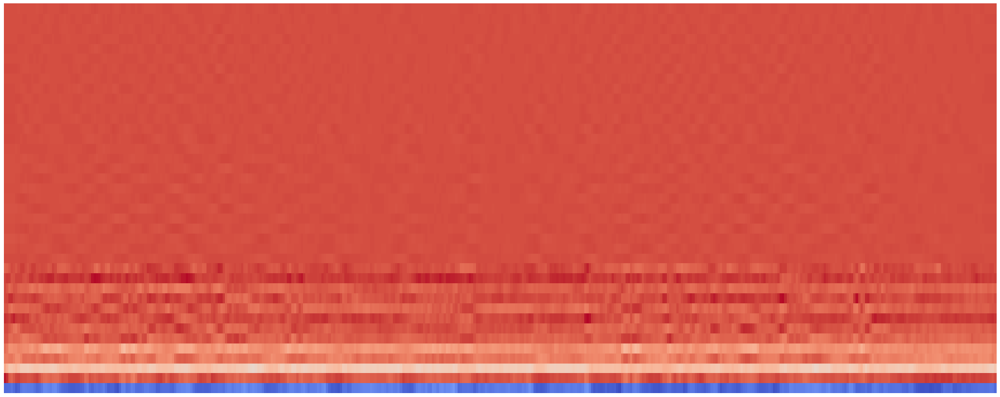

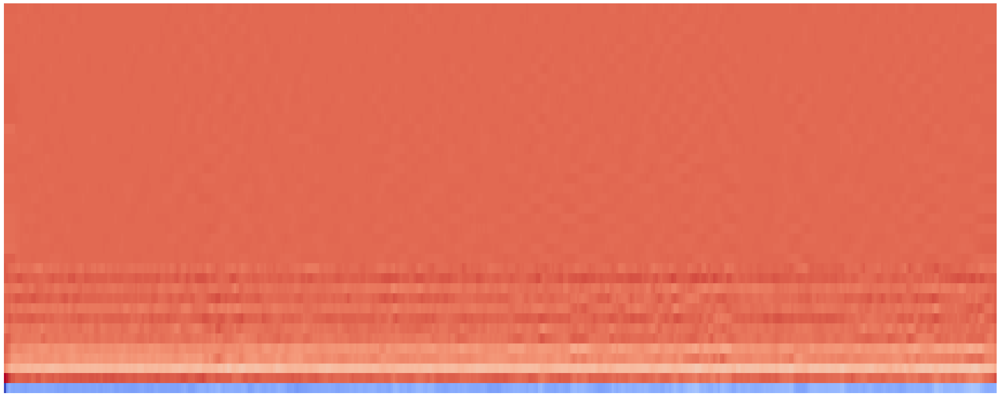

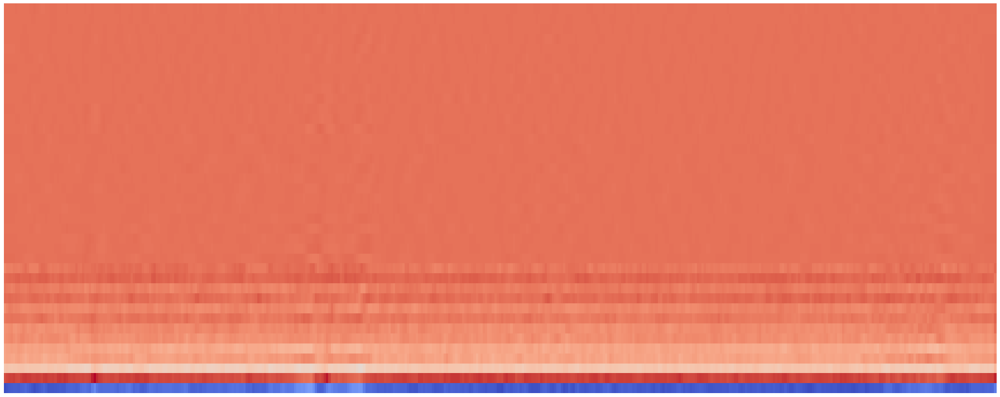

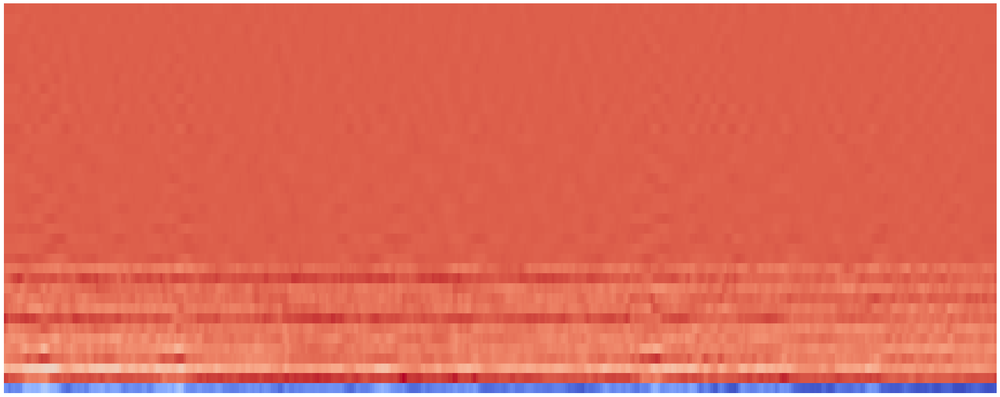

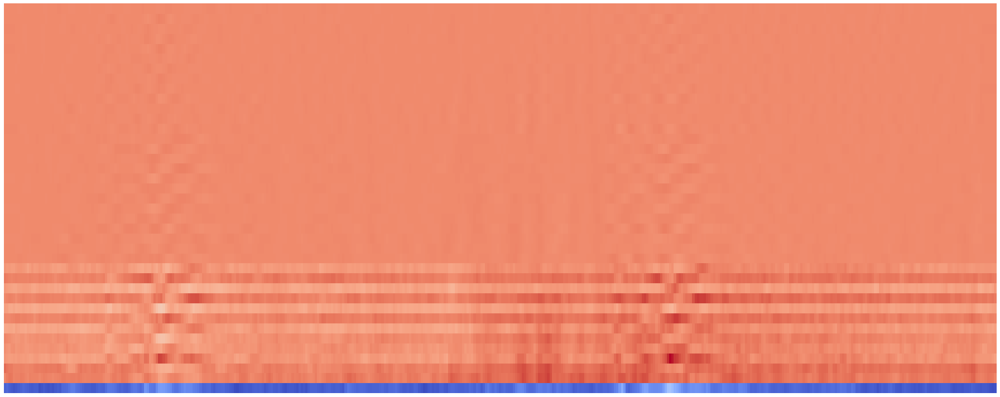

...

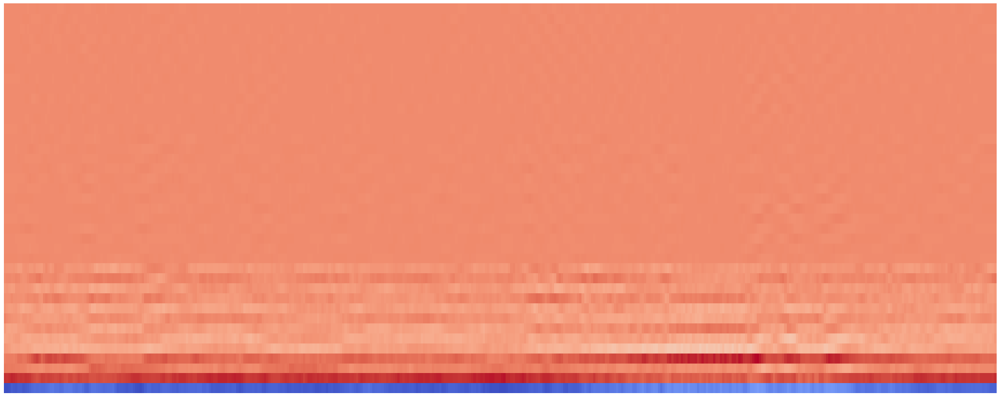

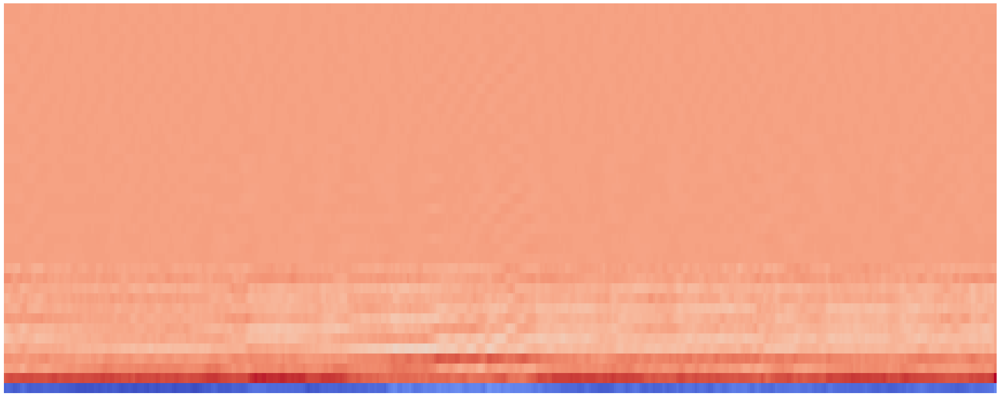

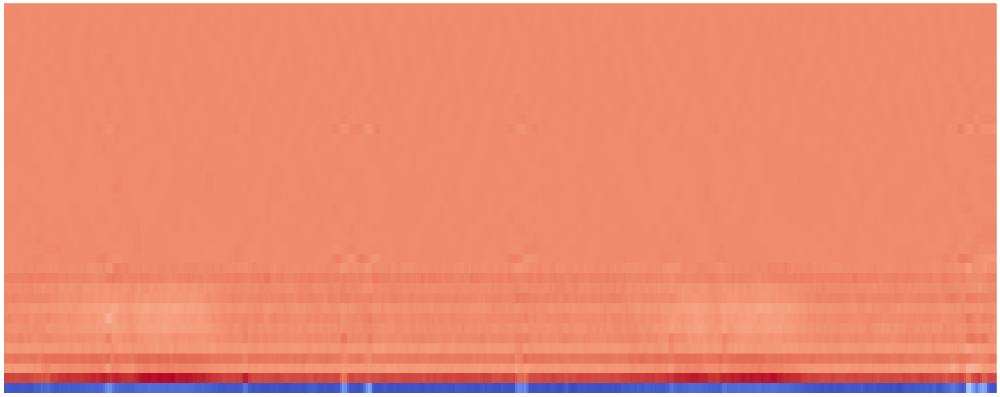

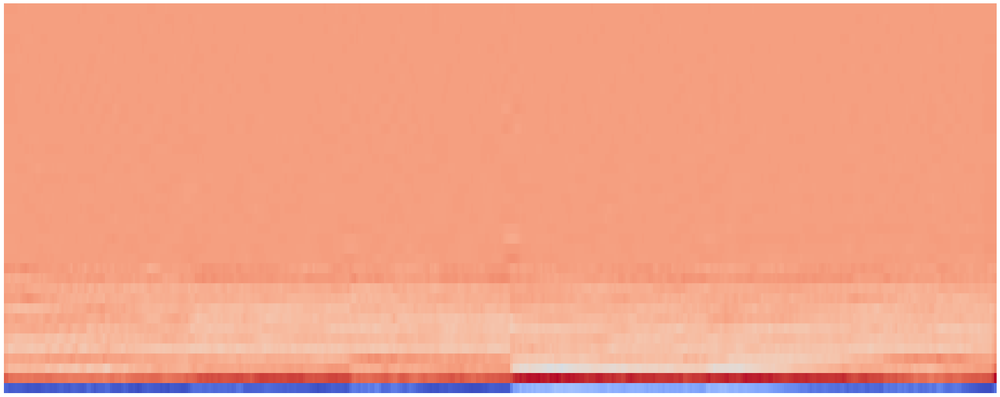

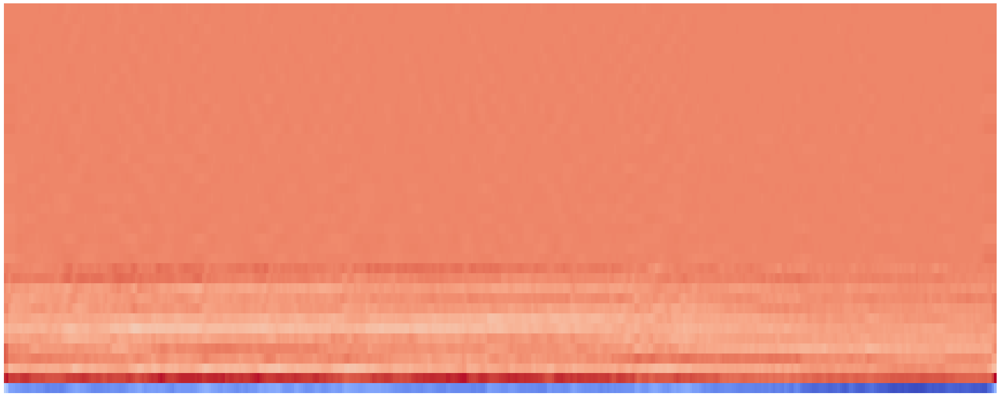

Error in callback <function flush_figures at 0x7ff3711ba200> (for post_execute):


KeyboardInterrupt: ignored

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import warnings
import os

warnings.filterwarnings("ignore")
PATH = '/content/drive/MyDrive/MajorProject/CharaNet'
SAVE_PATH = '/content/DataMFCC/'

for train_val_test in ['train', 'val', 'test']:
# for train_val_test in ['test']:
    DATA_PATH = f'{PATH}/{train_val_test}'

    BIRDS = os.listdir(DATA_PATH)
    # BIRDS = INCLUDE_BIRDS
    os.chdir('/content')
    os.makedirs(f'DataMFCC/{train_val_test}')
    os.chdir(f'{SAVE_PATH}{train_val_test}')
    
    for bird in BIRDS:
        count = 0
        os.mkdir(bird)
        os.chdir(f'{SAVE_PATH}{train_val_test}/{bird}')

        # Load the mp3 file
        audio_files = os.listdir(os.path.join(DATA_PATH, bird))
        print(f"{train_val_test}: {bird} Started!!")
        for audio_data in audio_files:
            signal, sr = librosa.load(os.path.join(DATA_PATH, bird, audio_data),duration=10) # sr = sampling rate

            # Plot MFCCs

            mfccs = librosa.feature.mfcc(y=signal, n_mfcc=13, sr=sr) 
            del_mfccs = librosa.feature.delta(mfccs)
            del2_mfccs = librosa.feature.delta(mfccs, order=2)
            mfccs_feat = np.concatenate((mfccs, del_mfccs, del2_mfccs))

            plt.figure(figsize=(25, 10))
            librosa.display.specshow(mfccs_feat, 
                                    x_axis="time", 
                                    sr=sr)
            plt.axis(False)
            plt.tight_layout()
            # plt.show()
            count += 1
            plt.savefig(f'{bird}{count}.jpg')

        print(f"{train_val_test}: {bird} Done!!")
        os.chdir(f'{SAVE_PATH}{train_val_test}')

In [ ]:
# import os
# import shutil
# shutil.rmtree('/content/DataMFCC_val_l1/val/Himalayan Monal')

In [ ]:
import os
import shutil

os.chdir('/content')
# output_filename = 'MFCC'
SAVE_PATH = '/content/DataMFCC_test_l1/'
source = SAVE_PATH
# shutil.make_archive(output_filename, 'zip', source)
destination = '/content/drive/MyDrive/MajorProject/temp/test_l1'
shutil.copytree(source, destination)

'/content/drive/MyDrive/MajorProject/temp/test_l1'

# MFCC Spectrogram without Delta

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import shutil
if 'DataMFCCTry' in os.listdir('/content'):
    shutil.rmtree('/content/DataMFCCTry')

In [ ]:
# exclude1 = os.listdir('/content/DataMFCC_val_l1/val')
# # exclude2 = os.listdir('/content/DataMFCC_l2/train')
# # exclude3 = os.listdir('/content/DataMFCC_l3/train')
# exclude = exclude1
exclude = os.listdir('/content/DataMFCCTry/val')
PATH = '/content/DataMFCCTry/train'
BIRDS = os.listdir(PATH)

INCLUDE_BIRDS = [bird for bird in BIRDS if bird not in exclude]
INCLUDE_BIRDS

['Black Kite',
 'Common Cuckoo',
 'Great Slaty Woodpecker',
 'Himalayan Monal',
 'Grey-sided Thrush',
 'Grey Treepie',
 'Spotted Dove']

test: Saker Falcon Started!!
test: Saker Falcon Done!!
test: Slender-billed Babbler Started!!
test: Slender-billed Babbler Done!!
test: Black-necked crane Started!!
test: Black-necked crane Done!!
test: Common Wood Pigeon Started!!
test: Common Wood Pigeon Done!!
test: House Sparrow Started!!
test: House Sparrow Done!!
test: Kashmir Flycatcher Started!!
test: Kashmir Flycatcher Done!!
test: Pallas_s Fish Eagle Started!!
test: Pallas_s Fish Eagle Done!!
test: Swamp Francolin Started!!
test: Swamp Francolin Done!!
test: Eastern Imperial Eagle Started!!
test: Eastern Imperial Eagle Done!!
test: Black-breasted Parrotbill Started!!
test: Black-breasted Parrotbill Done!!
test: Steppe Eagle Started!!
test: Steppe Eagle Done!!
test: House Crow Started!!
test: House Crow Done!!
test: Rustic Bunting Started!!
test: Rustic Bunting Done!!
test: Bristled Grassbird Started!!
test: Bristled Grassbird Done!!
test: White-throated Bushchat Started!!
test: White-throated Bushchat Done!!
test: Wood Snipe 

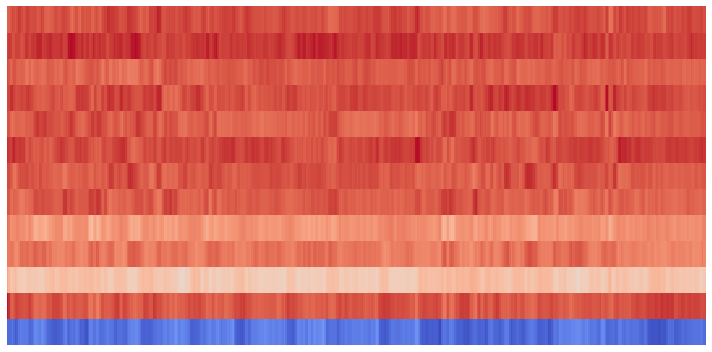

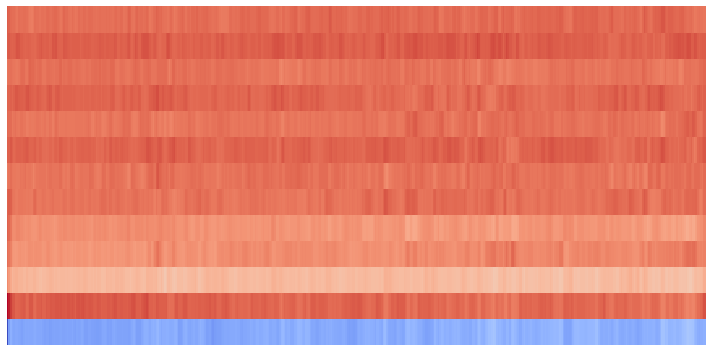

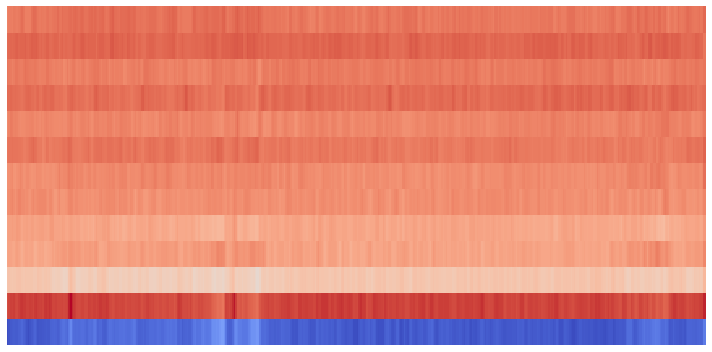

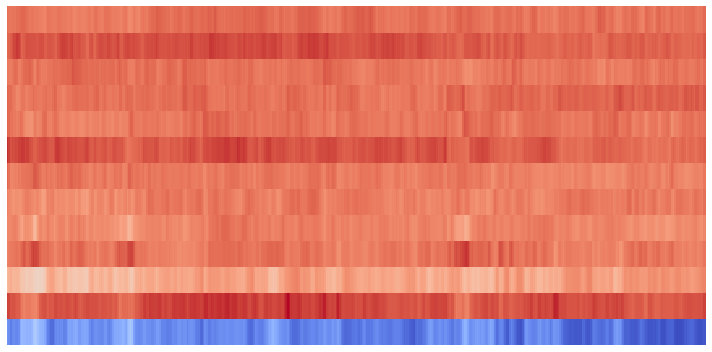

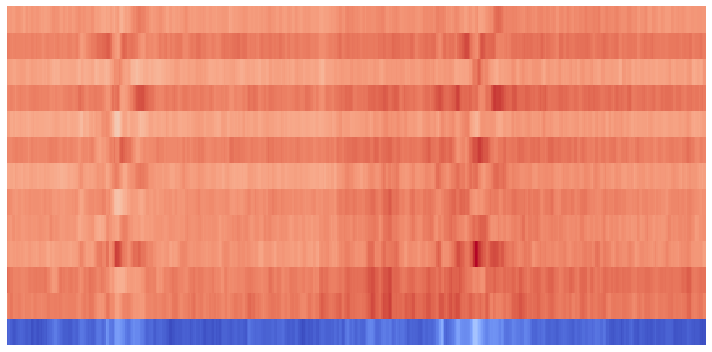

...

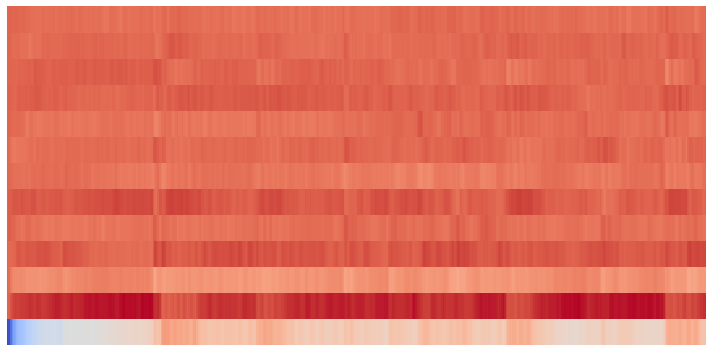

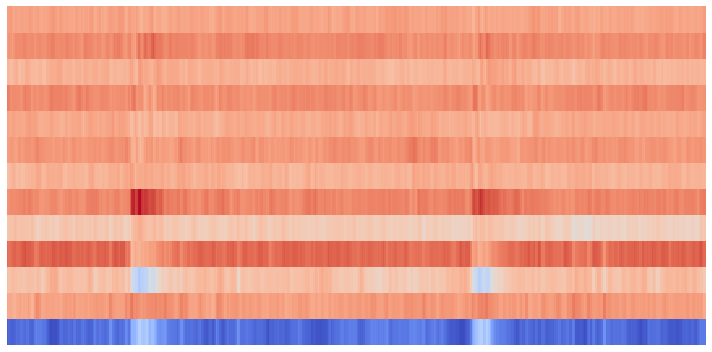

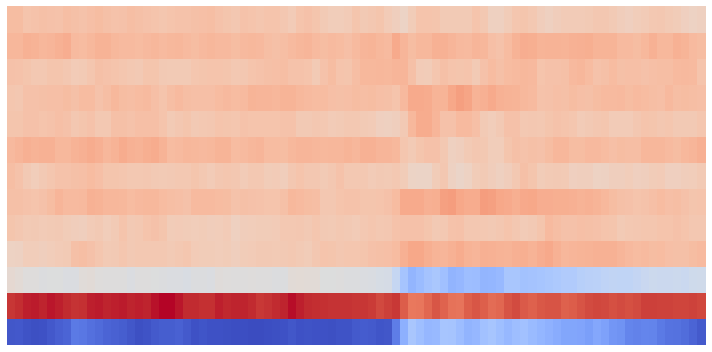

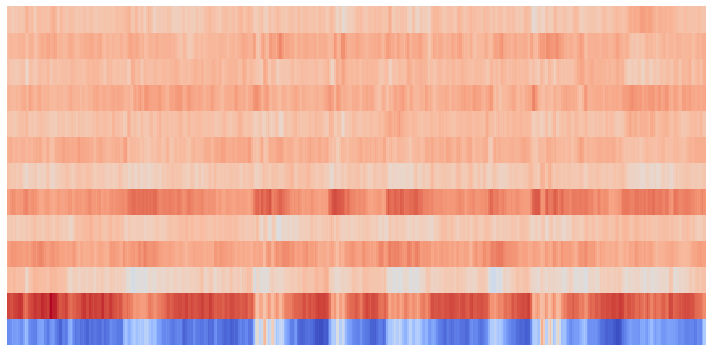

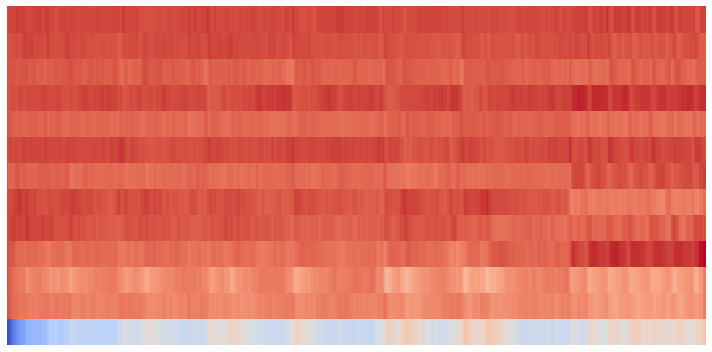

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import warnings
import os

warnings.filterwarnings("ignore")
PATH = '/content/drive/MyDrive/MajorProject/CharaNet'
SAVE_PATH = '/content/DataMFCCTryTest/'

# for train_val_test in ['train', 'val', 'test']:
for train_val_test in ['test']:
    DATA_PATH = f'{PATH}/{train_val_test}'

    BIRDS = os.listdir(DATA_PATH)
    # BIRDS = INCLUDE_BIRDS
    os.chdir('/content')
    os.makedirs(f'DataMFCCTryTest/{train_val_test}')
    os.chdir(f'{SAVE_PATH}{train_val_test}')
    
    for bird in BIRDS:
        count = 0
        os.mkdir(bird)
        os.chdir(f'{SAVE_PATH}{train_val_test}/{bird}')

        # Load the mp3 file
        audio_files = os.listdir(os.path.join(DATA_PATH, bird))
        print(f"{train_val_test}: {bird} Started!!")
        for audio_data in audio_files:
            signal, sr = librosa.load(os.path.join(DATA_PATH, bird, audio_data), duration=10) # sr = sampling rate

            # Plot MFCCs

            mfccs = librosa.feature.mfcc(y=signal, n_mfcc=13, sr=sr) 
            # del_mfccs = librosa.feature.delta(mfccs)
            # del2_mfccs = librosa.feature.delta(mfccs, order=2)
            # mfccs_feat = np.concatenate((mfccs, del_mfccs, del2_mfccs))

            plt.figure(figsize=(10, 5))
            librosa.display.specshow(mfccs, 
                                    x_axis="time", 
                                    sr=sr)
            plt.axis(False)
            plt.tight_layout()
            # plt.show()
            count += 1
            plt.savefig(f'{bird}{count}.jpg')

        print(f"{train_val_test}: {bird} Done!!")
        os.chdir(f'{SAVE_PATH}{train_val_test}')

In [ ]:
# import os
# import shutil
# shutil.rmtree('/content/DataMFCCTry/val/Common Cuckoo')

# Inference Mel Spec


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Import Required Modules

import os
import numpy as np

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.keras.applications.efficientnet import preprocess_input

import warnings
warnings.filterwarnings("ignore")

In [ ]:
# BIRDS = ['House Sparrow', 'Asian Koel', 'Black Kite', 'Black-breasted Parrotbill', 'Black-necked crane', 'Bristled Grassbird', 'Cheer Pheasant', 'Common Cuckoo', 'Common Pochard', 'Common Wood Pigeon', 'Eastern Imperial Eagle', 'Egyptian Vulture', 'Great Slaty Woodpecker', 'Greater Spotted Eagle', 'Grey Treepie', 'Grey-crowned Prinia', 'Grey-sided Thrush', 'Himalayan Monal', 'House Crow', 'Indian Spotted Eagle', 'Jerdon_s Babbler', 'Kashmir Flycatcher', 'Large-billed Crow', 'Long-tailed Duck', 'Pallas_s Fish Eagle', 'Red-billed Blue Magpie', 'Rose-ringed Parakeet', 'Rufous Treepie', 'Rufous-necked Hornbill', 'Rustic Bunting', 'Saker Falcon', 'Sarus Crane', 'Satyr Tragopan', 'Slender-billed Babbler', 'Spiny Babbler', 'Spotted Dove', 'Steppe Eagle', 'Swamp Francolin', 'Swamp Grass-babbler', 'White-throated Bushchat', 'Wood Snipe']

# Kaggle ko tala ko
BIRDS = ['Spotted Dove', 'Swamp Francolin', 'Rufous-necked Hornbill',
 'Jerdon_s Babbler', 'Rose-ringed Parakeet', 'Wood Snipe',
 'Large-billed Crow', 'Greater Spotted Eagle', 'Saker Falcon',
 'Rufous Treepie', 'Indian Spotted Eagle', 'Satyr Tragopan',
 'Steppe Eagle', 'House Crow', 'Long-tailed Duck',
 'Asian Koel', 'Red-billed Blue Magpie', 'Pallas_s Fish Eagle',
 'Cheer Pheasant', 'Rustic Bunting', 'Grey Treepie',
 'Sarus Crane', 'Spiny Babbler', 'Kashmir Flycatcher',
 'Swamp Grass-babbler', 'Great Slaty Woodpecker', 'Eastern Imperial Eagle',
 'Black Kite', 'Black-necked crane', 'Common Wood Pigeon',
 'Bristled Grassbird', 'Grey-sided Thrush', 'House Sparrow',
 'Grey-crowned Prinia', 'White-throated Bushchat', 'Himalayan Monal',
 'Black-breasted Parrotbill', 'Egyptian Vulture', 'Common Pochard',
 'Common Cuckoo', 'Slender-billed Babbler']
BATCH_SIZE = 2
IM_SIZE = (128, 128) 
NO_CLASSES = len(BIRDS)

In [ ]:
DATA_PATH = '/content/drive/MyDrive/MajorProject/CharaNetMelSpec'

test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                 rescale=1./255)
test_batches = test_datagen.flow_from_directory(
    os.path.join(DATA_PATH, "test"),
    classes=BIRDS,
    target_size=IM_SIZE,
    class_mode="categorical",
    shuffle=False,
    batch_size=BATCH_SIZE,
)

Found 687 images belonging to 41 classes.


In [ ]:
effnet_melspec_model_path = '/content/drive/MyDrive/MajorProject/After7thSem/Saved Models/CNMelSpec_Model'
custom_cnn_melspec_model_path = '/content/drive/MyDrive/MajorProject/After7thSem/Saved Models/CNMelSpecVanilla_Model'

model = load_model(effnet_melspec_model_path)
model.evaluate(test_batches)

344/344 [==============================] - 169s 480ms/step - loss: 0.7815 - accuracy: 0.7889


[0.7814986109733582, 0.7889373898506165]

In [ ]:
model = load_model(custom_cnn_melspec_model_path)
model.evaluate(test_batches)

344/344 [==============================] - 13s 37ms/step - loss: 1.2585 - accuracy: 0.6565


[1.2585010528564453, 0.6564774513244629]

In [ ]:
!pip install -q pydub

In [ ]:
# Manual Inference Start

import os
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import Rescaling

from pydub import AudioSegment
import math
import shutil

import warnings
warnings.filterwarnings("ignore")

# # Turn interactive plotting off
# import matplotlib
# matplotlib.use('Agg')
# plt.ioff()

# Variables for feature extraction
SAMPLE_RATE = 32000
SPEC_SHAPE = (48, 128) # height x width
SIGNAL_LENGTH = 10
N_FFT = 1024         
HOP_SIZE =  int(SIGNAL_LENGTH * SAMPLE_RATE / (SPEC_SHAPE[1] - 1))      
N_MELS = SPEC_SHAPE[0]   
WIN_SIZE = 1024      
WINDOW_TYPE = 'hann' 
FEATURE = 'mel'      
FMIN = 500
FMAX = 12500

def SplitAudio(audio_file, sec_to_split=10):
    
    validAudio = lambda audio, amp_threshold: True if audio.max > amp_threshold else False
    
    global temp_n
    temp_n = 0
    mili=1000
    export_folder = f'./inference/tmp'
    export_name = audio_file.split('/')[-1]
    exportFormat = 'mp3'
    try:
        audio = AudioSegment.from_mp3(audio_file)
    except:
        print("File handled: ", audio_file)
        extension = audio_file.split('.')[-1]
        if extension == 'wav':
            audio = AudioSegment.from_wav(audio_file)
        elif extension == 'ogg':
            audio = AudioSegment.from_ogg(audio_file)
    th = audio.max//2
 
    duration = math.floor(audio.duration_seconds)
    splits = np.arange(0, duration, sec_to_split)

    if duration > sec_to_split:
        rem = duration % sec_to_split
        n_splits = round(duration / sec_to_split)
        for n in range(n_splits-1): # Except last splitted file
            newAudio = audio[splits[n]*mili:splits[n+1]*mili]
            temp_n = n
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n}.{exportFormat}', format=exportFormat)
        
        # For the last splitted file
        if rem <= sec_to_split//2:
            n = temp_n
            # If remaining  audio is small enough, don't separate
            newAudio = audio[splits[n+1]*mili:duration*mili]
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n+1}.{exportFormat}', format=exportFormat)

        else:
            n = temp_n
            # If remaining audio is big enough, make it separate file
            newAudio = audio[splits[n+1]*mili:duration*mili]
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n+1}.{exportFormat}', format=exportFormat)

    else:
        if validAudio(audio, th):
            audio.export(f'{export_folder}/{export_name}original.{exportFormat}', format=exportFormat)

def create_features(inference_data_path):
    
    # Find the list of all 10 sec splitted audio files
    audio_files = [f for f in os.listdir(inference_data_path) if f.split('.')[-1]=='mp3']
    count = 0
    for aud in audio_files:

        signal, sr = librosa.load(os.path.join(inference_data_path, aud),duration=10, sr=SAMPLE_RATE) # sr = sampling rate
        # Plot mel-spectrogram
        S = librosa.feature.melspectrogram(y=signal,
                                           sr=SAMPLE_RATE,
                                            n_fft=N_FFT,
                                            hop_length=HOP_SIZE, 
                                            n_mels=N_MELS, 
                                            fmin=FMIN, 
                                            fmax=FMAX) 

        fig = plt.figure(figsize=(10, 4))
        mel_spec = librosa.power_to_db(S, ref=np.max) 
        librosa.display.specshow(mel_spec, fmin=FMIN,y_axis='linear')

        plt.axis(False)
        plt.tight_layout()
        # plt.show()
        count += 1
        plt.savefig(f'{inference_data_path}/inf{count}.jpg')
        plt.close(fig)
        
def preprocess_img(image_dir, img_size):
    img_width, img_height = img_size[0], img_size[1]
    img = image.load_img(image_dir, target_size = (img_width, img_height))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis = 0)
    norm = Rescaling(1./255)
    img = norm(img)
    img = preprocess_input(img) 
    return img

def prediction(model_dir, inference_data_path, img_size):
    # List of feature images
    feat = [os.path.join(inference_data_path, f) for f in os.listdir(inference_data_path) if f.split('.')[-1]=='jpg']
    results = []
    model_loaded = load_model(model_dir)
    for m in feat:
        img = preprocess_img(m, img_size)
        output = BIRDS[np.argmax(model_loaded.predict(img), axis=-1)[0]]
        results.append(output)
    result = max(results)
    
    # Remove the temporary splitted audio and mfcc images
    for i in os.listdir(inference_data_path):
        os.remove(os.path.join(inference_data_path, i))
    return results

THIS FILEEEE:  XC195058 3.mp3


NameError: ignored

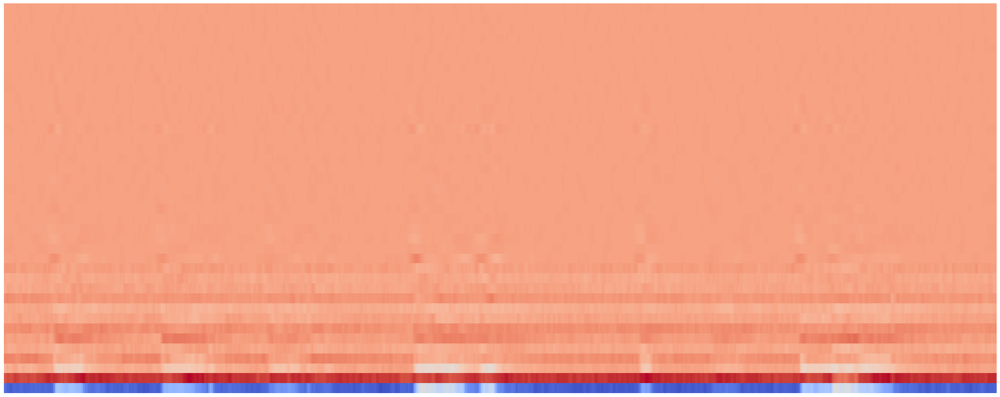

In [ ]:
# For evaluating validation dataset manually

ans = []

warnings.filterwarnings("ignore")

def inference(raw_data_path):
  inference_data_path = './inference/tmp'
  model_dir = '/content/drive/MyDrive/MajorProject/After7thSem/Saved Models/CNMFCC_Model'
  img_size = (224, 224)

  if 'inference' not in os.listdir('./'):
      os.makedirs(inference_data_path)

  SplitAudio(raw_data_path)
  create_features(inference_data_path)
  result = prediction(model_dir, inference_data_path, img_size)
  print(max(result))
  ans.append(max(result))
  return ans

audio_files = [f for f in os.listdir('/content') if '.mp3' in f]
for af in audio_files:
  print("THIS FILEEEE: ", af)
  ans = inference(os.path.join('/content', af))

In [ ]:
# ans

['House Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'House Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow']

In [ ]:
inference_data_path = './inference/tmp'
raw_data_path = '/content/XC156335 1.mp3'
# model_dir = '/content/drive/MyDrive/MajorProject/After7thSem/Saved Models/CNMelSpec_Model'
model_dir = '/content/drive/MyDrive/MajorProject/After7thSem/Saved Models/CNMelSpecVanilla_Model'
img_size = (128, 128)

if 'inference' not in os.listdir('./'):
    os.makedirs(inference_data_path)

SplitAudio(raw_data_path)
create_features(inference_data_path)
result = prediction(model_dir, inference_data_path, img_size)
print(max(result))

1/1 [==============================] - 0s 209ms/step
Large-billed Crow


# Inference MFCC

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Import Required Modules

import os
import numpy as np

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.keras.applications.efficientnet import preprocess_input

import warnings
warnings.filterwarnings("ignore")

In [ ]:
# BIRDS = ['House Sparrow', 'Asian Koel', 'Black Kite', 'Black-breasted Parrotbill', 'Black-necked crane', 'Bristled Grassbird', 'Cheer Pheasant', 'Common Cuckoo', 'Common Pochard', 'Common Wood Pigeon', 'Eastern Imperial Eagle', 'Egyptian Vulture', 'Great Slaty Woodpecker', 'Greater Spotted Eagle', 'Grey Treepie', 'Grey-crowned Prinia', 'Grey-sided Thrush', 'Himalayan Monal', 'House Crow', 'Indian Spotted Eagle', 'Jerdon_s Babbler', 'Kashmir Flycatcher', 'Large-billed Crow', 'Long-tailed Duck', 'Pallas_s Fish Eagle', 'Red-billed Blue Magpie', 'Rose-ringed Parakeet', 'Rufous Treepie', 'Rufous-necked Hornbill', 'Rustic Bunting', 'Saker Falcon', 'Sarus Crane', 'Satyr Tragopan', 'Slender-billed Babbler', 'Spiny Babbler', 'Spotted Dove', 'Steppe Eagle', 'Swamp Francolin', 'Swamp Grass-babbler', 'White-throated Bushchat', 'Wood Snipe']

# Kaggle ko tala ko
BIRDS = ['Spotted Dove', 'Swamp Francolin', 'Rufous-necked Hornbill',
 'Jerdon_s Babbler', 'Rose-ringed Parakeet', 'Wood Snipe',
 'Large-billed Crow', 'Greater Spotted Eagle', 'Saker Falcon',
 'Rufous Treepie', 'Indian Spotted Eagle', 'Satyr Tragopan',
 'Steppe Eagle', 'House Crow', 'Long-tailed Duck',
 'Asian Koel', 'Red-billed Blue Magpie', 'Pallas_s Fish Eagle',
 'Cheer Pheasant', 'Rustic Bunting', 'Grey Treepie',
 'Sarus Crane', 'Spiny Babbler', 'Kashmir Flycatcher',
 'Swamp Grass-babbler', 'Great Slaty Woodpecker', 'Eastern Imperial Eagle',
 'Black Kite', 'Black-necked crane', 'Common Wood Pigeon',
 'Bristled Grassbird', 'Grey-sided Thrush', 'House Sparrow',
 'Grey-crowned Prinia', 'White-throated Bushchat', 'Himalayan Monal',
 'Black-breasted Parrotbill', 'Egyptian Vulture', 'Common Pochard',
 'Common Cuckoo', 'Slender-billed Babbler']
BATCH_SIZE = 2
IM_SIZE = (224, 224) 
NO_CLASSES = len(BIRDS)

In [ ]:
DATA_PATH = '/content/drive/MyDrive/MajorProject/CharaNetMFCC'
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
test_batches = test_datagen.flow_from_directory(
    os.path.join(DATA_PATH, "test"),
    classes=BIRDS,
    target_size=IM_SIZE,
    class_mode="categorical",
    shuffle=False,
    batch_size=BATCH_SIZE,
)

Found 687 images belonging to 41 classes.


In [ ]:
model_path = '/content/drive/MyDrive/MajorProject/8th Sem/Saved Models/CNMFCC_Model'
model = load_model(model_path)
model.evaluate(test_batches)

344/344 [==============================] - 147s 421ms/step - loss: 1.1073 - accuracy: 0.7278


[1.1073384284973145, 0.727802038192749]

In [ ]:
!pip install -q pydub

In [ ]:
# Manual Inference Start

import os
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import Rescaling

from pydub import AudioSegment
import math
import shutil

import warnings
warnings.filterwarnings("ignore")

# SAMPLE_RATE = 32000
def SplitAudio(audio_file, sec_to_split=10):
    
    validAudio = lambda audio, amp_threshold: True if audio.max > amp_threshold else False
    
    global temp_n
    temp_n = 0
    mili=1000
    export_folder = f'./inference/tmp'
    export_name = audio_file.split('/')[-1]
    exportFormat = 'mp3'
    try:
        audio = AudioSegment.from_mp3(audio_file)
    except:
        print("File handled: ", audio_file)
        extension = audio_file.split('.')[-1]
        if extension == 'wav':
            audio = AudioSegment.from_wav(audio_file)
        elif extension == 'ogg':
            audio = AudioSegment.from_ogg(audio_file)
    th = audio.max//2
 
    duration = math.floor(audio.duration_seconds)
    splits = np.arange(0, duration, sec_to_split)

    if duration > sec_to_split:
        rem = duration % sec_to_split
        n_splits = round(duration / sec_to_split)
        for n in range(n_splits-1): # Except last splitted file
            newAudio = audio[splits[n]*mili:splits[n+1]*mili]
            temp_n = n
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n}.{exportFormat}', format=exportFormat)
        
        # For the last splitted file
        if rem <= sec_to_split//2:
            n = temp_n
            # If remaining  audio is small enough, don't separate
            newAudio = audio[splits[n+1]*mili:duration*mili]
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n+1}.{exportFormat}', format=exportFormat)

        else:
            n = temp_n
            # If remaining audio is big enough, make it separate file
            newAudio = audio[splits[n+1]*mili:duration*mili]
            if validAudio(newAudio, th):
                newAudio.export(f'{export_folder}/{export_name}{n+1}.{exportFormat}', format=exportFormat)

    else:
        if validAudio(audio, th):
            audio.export(f'{export_folder}/{export_name}original.{exportFormat}', format=exportFormat)

def create_features(inference_data_path):
    
    # Find the list of all 10 sec splitted audio files
    audio_files = [f for f in os.listdir(inference_data_path) if f.split('.')[-1]=='mp3']
    count = 0
    for aud in audio_files:
        signal, sr = librosa.load(os.path.join(inference_data_path, aud), duration=10) # sr = sampling rate

        # Plot MFCCs
        mfccs = librosa.feature.mfcc(y=signal, n_mfcc=13, sr=sr) 
        # del_mfccs = librosa.feature.delta(mfccs)
        # del2_mfccs = librosa.feature.delta(mfccs, order=2)
        # mfccs_feat = np.concatenate((mfccs, del_mfccs, del2_mfccs))

        fig = plt.figure(figsize=(10, 5))
        librosa.display.specshow(mfccs, 
                                x_axis="time", 
                                sr=sr)
        plt.axis(False)
        plt.tight_layout()
        # plt.show()
        count += 1
        plt.savefig(f'{inference_data_path}/inf{count}.jpg')
        plt.close(fig)
        
def preprocess_img(image_dir, img_size):
    img_width, img_height = img_size[0], img_size[1]
    img = image.load_img(image_dir, target_size = (img_width, img_height))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis = 0)
    img = preprocess_input(img) 
    return img

def prediction(model_dir, inference_data_path, img_size):
    # List of feature images
    feat = [os.path.join(inference_data_path, f) for f in os.listdir(inference_data_path) if f.split('.')[-1]=='jpg']
    results = []
    model_loaded = load_model(model_dir)
    for m in feat:
        img = preprocess_img(m, img_size)
        output = BIRDS[np.argmax(model_loaded.predict(img), axis=-1)[0]]
        results.append(output)
    result = max(results)
    
    # Remove the temporary splitted audio and mfcc images
    for i in os.listdir(inference_data_path):
        os.remove(os.path.join(inference_data_path, i))
    return results


In [ ]:
# For evaluating validation dataset manually

ans = []

warnings.filterwarnings("ignore")

def inference(raw_data_path):
  inference_data_path = './inference/tmp'
  model_dir = '/content/drive/MyDrive/MajorProject/8th Sem/Saved Models/CNMFCC_Model'
  img_size = (224, 224)

  if 'inference' not in os.listdir('./'):
      os.makedirs(inference_data_path)

  SplitAudio(raw_data_path)
  create_features(inference_data_path)
  result = prediction(model_dir, inference_data_path, img_size)
  print(max(result))
  ans.append(max(result))
  return ans

audio_files = [f for f in os.listdir('/content') if '.mp3' in f]
for af in audio_files:
  print("THIS FILEEEE: ", af)
  ans = inference(os.path.join('/content', af))

In [ ]:
ans

['Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'House Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow',
 'Large-billed Crow']

In [ ]:
inference_data_path = './inference/tmp'
raw_data_path = '/content/XC156096 4.mp3'
model_dir = '/content/drive/MyDrive/MajorProject/After7thSem/Saved Models/CNMFCC_Model'
img_size = (224, 224)

if 'inference' not in os.listdir('./'):
    os.makedirs(inference_data_path)

SplitAudio(raw_data_path)
create_features(inference_data_path)
result = prediction(model_dir, inference_data_path, img_size)
print(max(result))